In [1]:
%load_ext autoreload
%autoreload 2
import tqdm, tqdm.notebook
tqdm.tqdm = tqdm.notebook.tqdm  # notebook-friendly progress bars
from pathlib import Path
import numpy as np

from hloc import extract_features, match_features, reconstruction, visualization, pairs_from_covisibility, pairs_from_exhaustive, pairs_from_minseong, pairs_from_retrieval, pairs_from_retrieval_rerank
from hloc.visualization import plot_images, read_image
from hloc.utils import viz_3d

# Setup

In [2]:
images = Path('datasets/etri12-ex/')
outputs = Path('outputs/etri12-ex-reranking-test/')
!rm -rf $outputs
sfm_pairs = outputs / 'pairs-sfm.txt'
loc_pairs = outputs / 'pairs-loc.txt'
sfm_pairs_re = outputs / 'pairs-sfm-retrieval.txt'
sfm_dir = outputs / 'sfm'
local_features = outputs / 'local_features.h5'
global_features = outputs / 'global_features.h5'
# local_features_q = outputs / 'local_features_q.h5'
# global_features_q = outputs / 'global_features_q.h5'
matches = outputs / 'matches.h5'
# loc_matches = outputs / 'loc_matches.h5'

feature_conf = extract_features.confs['disk']
g_feature_conf = extract_features.confs['cosplace']
matcher_conf = match_features.confs['disk+lightglue']

# 3D mapping

In [3]:
references = [p.relative_to(images).as_posix() for p in (images / 'mapping/').iterdir()]
print(len(references), "mapping images")
# plot_images([read_image(images / r) for r in references], dpi=25)

195 mapping images


In [4]:
extract_features.main(feature_conf, images, image_list=references, feature_path=local_features)

[2023/08/28 15:50:45 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/195 [00:00<?, ?it/s]

[2023/08/28 15:50:54 hloc INFO] Finished exporting features.


PosixPath('outputs/etri12-ex-reranking-test/local_features.h5')

In [5]:
extract_features.main(image_dir=images, conf=g_feature_conf, image_list=references, feature_path=global_features)

[2023/08/28 15:50:54 hloc INFO] Extracting local features with configuration:
{'model': {'name': 'cosplace'},
 'output': 'global-feats-cosplace',
 'preprocessing': {'resize_max': 1024}}
Using cache found in /home/minseong/.cache/torch/hub/gmberton_CosPlace_main


Returning CosPlace model with backbone: ResNet50 with features dimension 2048


  0%|          | 0/195 [00:00<?, ?it/s]

[2023/08/28 15:50:58 hloc INFO] Finished exporting features.


PosixPath('outputs/etri12-ex-reranking-test/global_features.h5')

In [6]:
# pairs_from_exhaustive.main(sfm_pairs, image_list=references)
# pairs_from_minseong.main(output=sfm_pairs, image_list=references)
pairs_from_retrieval_rerank.main(descriptors=global_features, output=sfm_pairs_re, num_matched=40)

[2023/08/28 15:50:59 hloc INFO] Extracting image pairs from a retrieval database.


1
2
3
4
5
7


[2023/08/28 15:50:59 hloc INFO] Found 7800 pairs.


tensor([101, 188,  74,   2, 166,  91,  66,  92, 151,  58, 140,  46, 162,  98,
        175,  34, 180, 178,  33,   6,   4, 150, 147,  84,  81, 127,  95,  45,
        168, 124, 111, 149, 155,  85, 158,  76,  79,  59,  80,  64],
       device='cuda:0')
tensor([0.9485, 0.9290, 0.9282, 0.9256, 0.8835, 0.8492, 0.8466, 0.8365, 0.8337,
        0.8301, 0.8256, 0.8249, 0.8197, 0.8196, 0.8153, 0.8131, 0.7967, 0.7839,
        0.7805, 0.6722, 0.6344, 0.6228, 0.6218, 0.6114, 0.6065, 0.6056, 0.5801,
        0.5198, 0.4385, 0.4144, 0.3816, 0.3494, 0.3439, 0.3318, 0.3067, 0.2965,
        0.2704, 0.2689, 0.2667, 0.2647], device='cuda:0')
mapping/frame19.jpg
mapping/IMG_6926.JPG
mapping/IMG_7198.JPG


In [7]:
match_features.main(matcher_conf, sfm_pairs_re, features=local_features, matches=matches);

[2023/08/28 15:50:59 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/4753 [00:00<?, ?it/s]

[2023/08/28 15:54:58 hloc INFO] Finished exporting matches.


[2023/08/28 15:54:58 hloc INFO] Creating an empty database...
[2023/08/28 15:54:59 hloc INFO] Importing images into the database...
[2023/08/28 15:55:00 hloc INFO] Importing features into the database...


  0%|          | 0/195 [00:00<?, ?it/s]

[2023/08/28 15:55:01 hloc INFO] Importing matches into the database...


  0%|          | 0/7800 [00:00<?, ?it/s]

[2023/08/28 15:55:06 hloc INFO] Performing geometric verification of the matches...
[2023/08/28 15:55:14 hloc INFO] Running 3D reconstruction...
W0828 15:58:14.166507 2018415 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable to perform dense Cholesky factorization.
W0828 15:58:14.170185 2018415 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable to perform dense Cholesky factorization.
W0828 15:58:14.173619 2018415 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable to perform dense Cholesky factorization.
W0828 15:58:14.277245 2018415 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable to perform dense Cholesky factorization.
W0828 15:58:14.314023 2018415 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable t

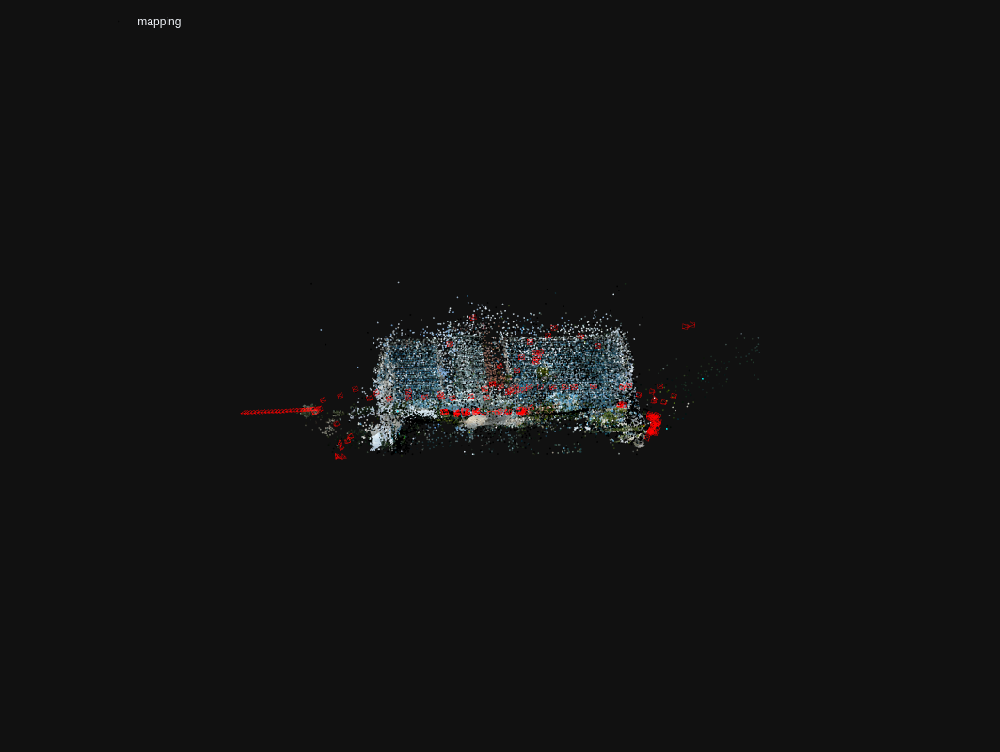

In [8]:
model = reconstruction.main(sfm_dir, images, sfm_pairs_re, local_features, matches, image_list=references)
fig = viz_3d.init_figure()
viz_3d.plot_reconstruction(fig, model, color='rgba(255,0,0,0.5)', name="mapping", points_rgb=True)
fig.show()

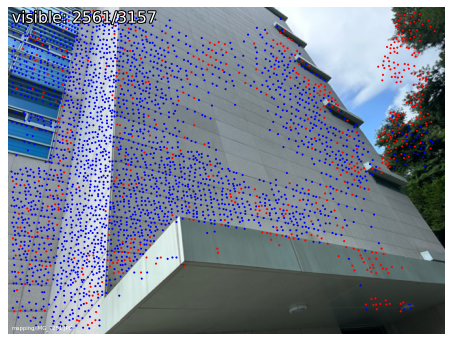

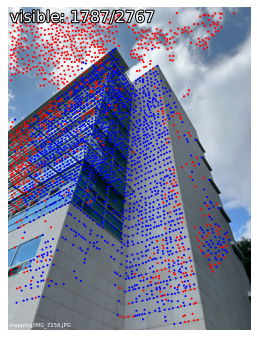

In [9]:
visualization.visualize_sfm_2d(model, images, color_by='visibility', n=2)

# Localization

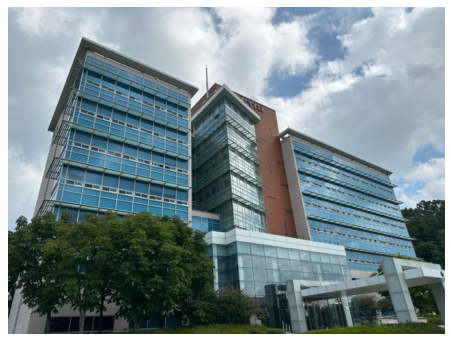

In [10]:
query = 'query/IMG_6864.JPG'
plot_images([read_image(images / query)], dpi=75)

In [11]:
extract_features.main(feature_conf, images, image_list=[query], feature_path=local_features, overwrite=True)
# extract_features.main(g_feature_conf, images, image_list=[query], feature_path=global_features, overwrite=True)
# pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references)
match_features.main(matcher_conf, loc_pairs, features=local_features, matches=matches, overwrite=True);

[2023/08/28 16:18:01 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2023/08/28 16:18:01 hloc INFO] Finished exporting features.
[2023/08/28 16:18:01 hloc INFO] Found 195 pairs.
[2023/08/28 16:18:01 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/195 [00:00<?, ?it/s]

[2023/08/28 16:18:16 hloc INFO] Finished exporting matches.


found 8446/15746 inlier correspondences.


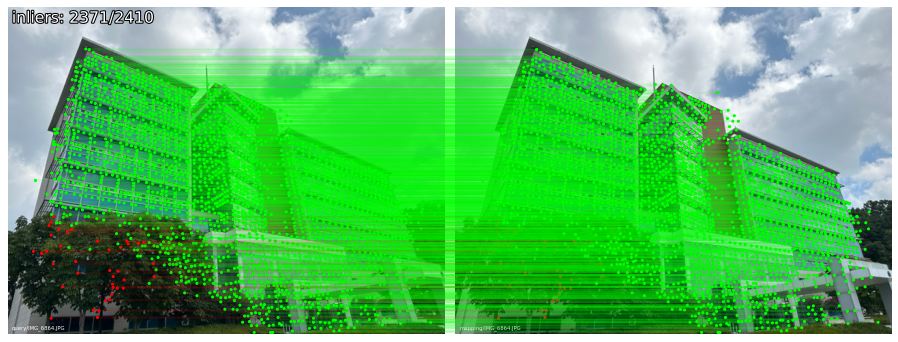

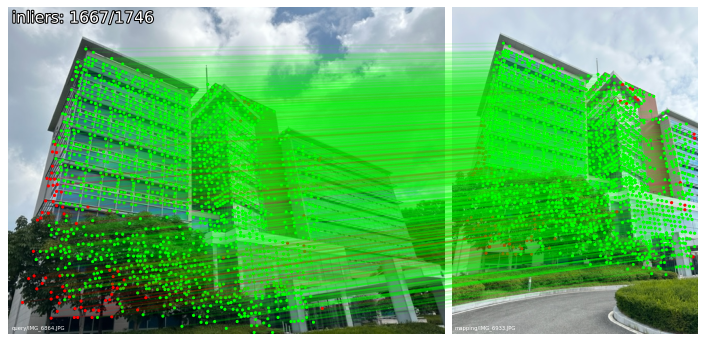

In [14]:
import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
# ref_ids = [model.find_image_with_name(r).image_id for r in references]
ref_ids = []
for reference in references:
    # print(model.find_image_with_name(reference).image_id)
    # print(reference)
    # print(model.find_image_with_name(reference))
    if model.find_image_with_name(reference) == None:
        continue
    else:
        ref_ids.append(model.find_image_with_name(reference).image_id)

conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, local_features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

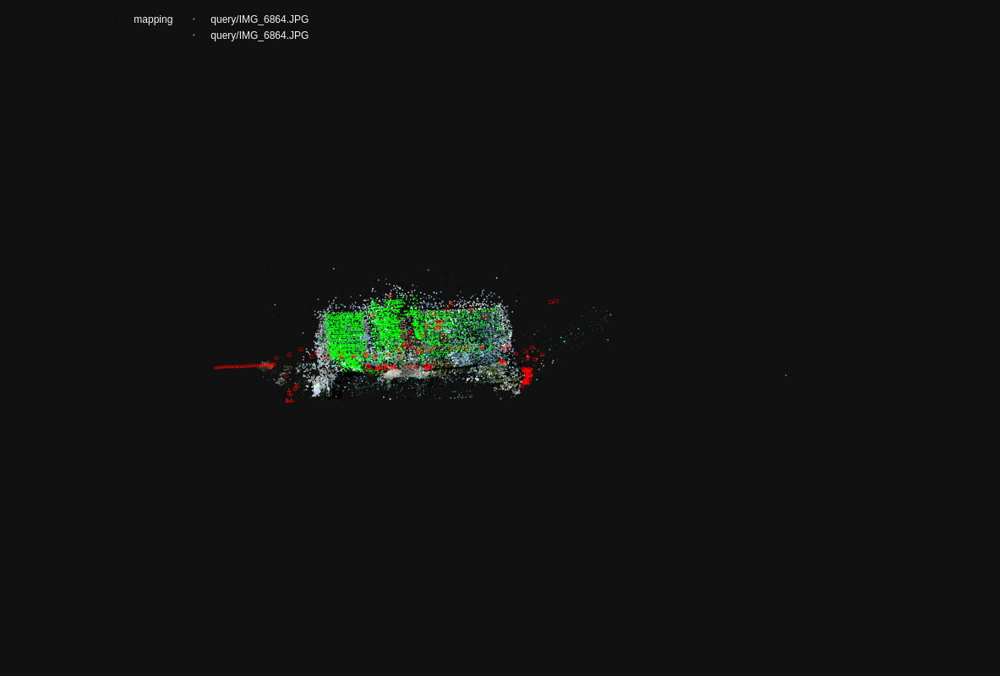

In [15]:
pose = pycolmap.Image(tvec=ret['tvec'], qvec=ret['qvec'])
viz_3d.plot_camera_colmap(fig, pose, camera, color='rgba(0,255,0,0.5)', name=query, fill=True)
# visualize 2D-3D correspodences
inl_3d = np.array([model.points3D[pid].xyz for pid in np.array(log['points3D_ids'])[ret['inliers']]])
viz_3d.plot_points(fig, inl_3d, color="lime", ps=1, name=query)
fig.show()